In [1]:
# 필요 라이브러리 불러오기
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import konlpy
okt = konlpy.tag.Okt()
import matplotlib.pyplot as plt
from matplotlib import font_manager, rc
plt.rcParams['axes.unicode_minus'] = False
f_path = '/Library/Fonts/Arial Unicode.ttf'
font_name = font_manager.FontProperties(fname = f_path).get_name()
rc('font', family = font_name)

import seaborn as sns
import PIL
icon = PIL.Image.open('../First_project/nationalassembly.png')
import numpy as np
img = PIL.Image.new("RGB", icon.size, (255,255,255))
img.paste(icon, icon)
img = np.array(img)
from wordcloud import WordCloud

In [2]:
# 회의록 df 불러오기
df = pd.read_csv('../First_project/dataes/04_21st_main_conf_change_columns.csv',
                 index_col = 0,
                 encoding = 'UTF-8')
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 17323 entries, 0 to 18456
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         17323 non-null  object
 1   confer_num   17323 non-null  int64 
 2   confer_name  17323 non-null  object
 3   dept_cd      17323 non-null  int64 
 4   con_name_kr  17323 non-null  object
 5   speaking     17323 non-null  object
dtypes: int64(2), object(4)
memory usage: 947.4+ KB


In [4]:
# 의원목록 df 불러오기
df1 = pd.read_csv('../First_project/dataes/Congress_members_fin.csv')

In [5]:
# deptCds변수에 의원목록 'deptCd' 호출하여 Series 생성
dept_cds = df1['dept_cd']
type(dept_cds)

pandas.core.series.Series

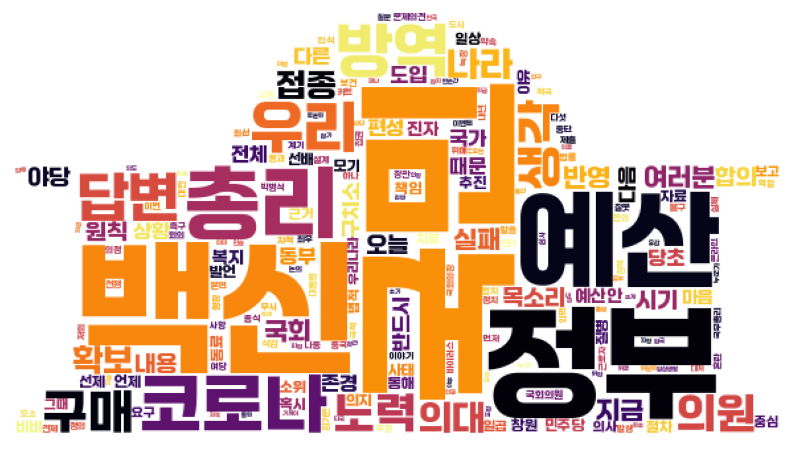

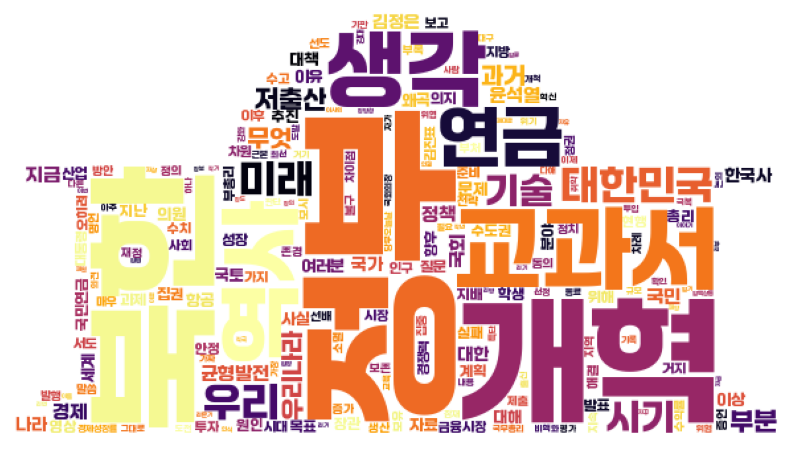

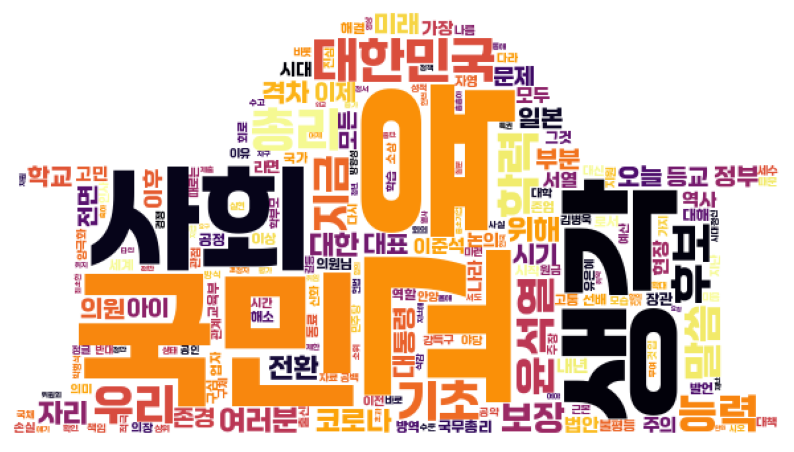

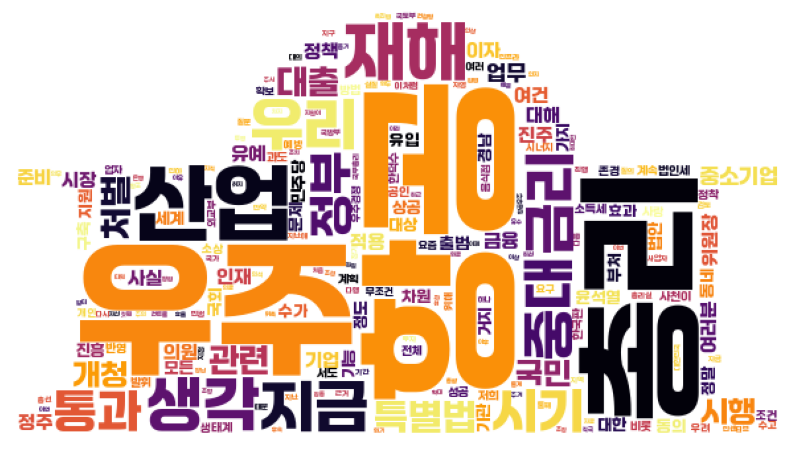

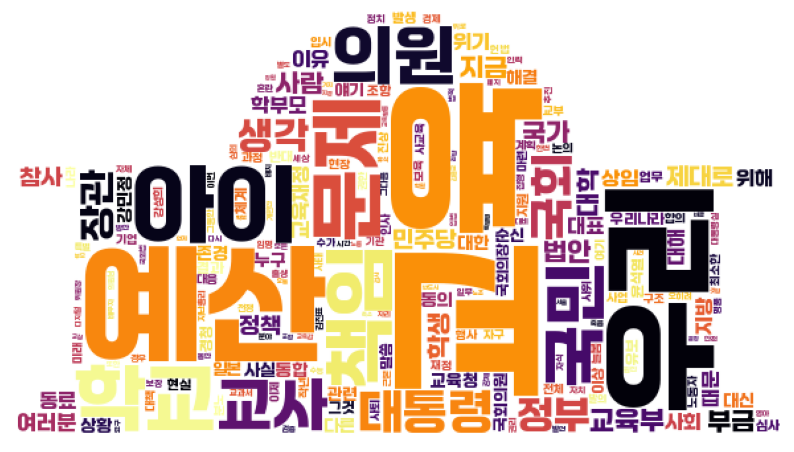

...

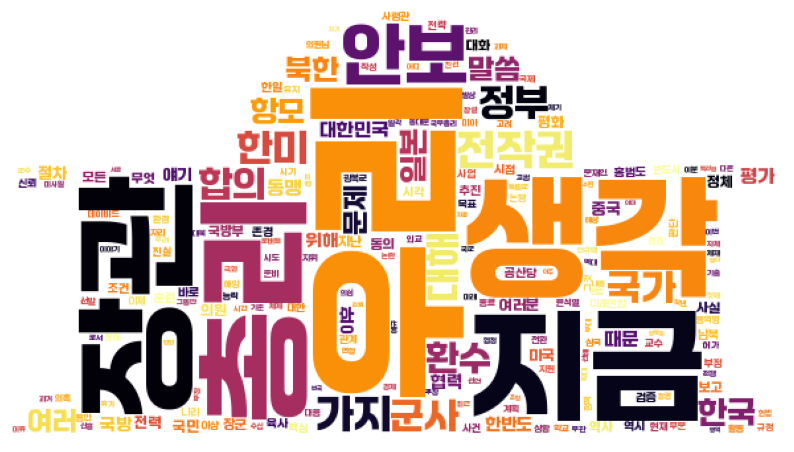

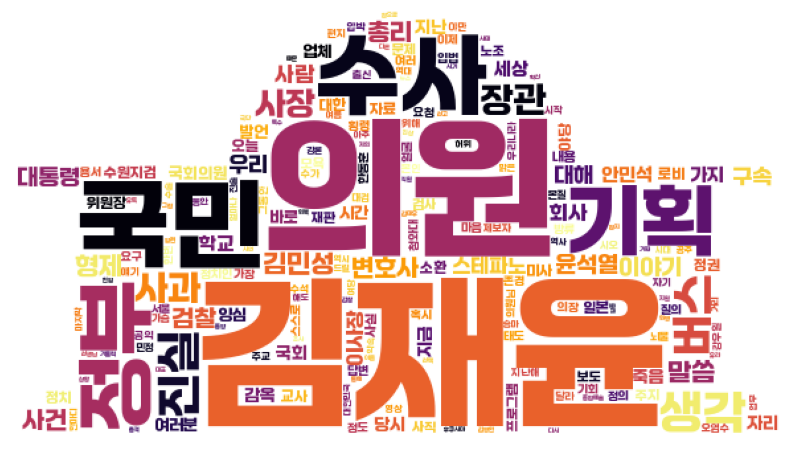

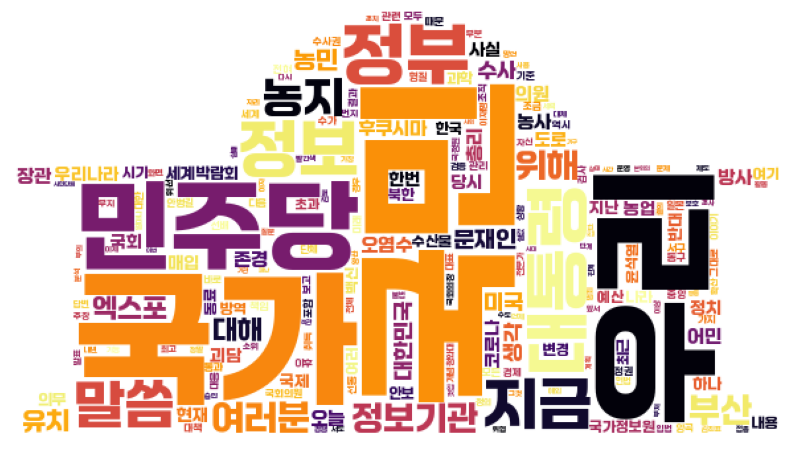

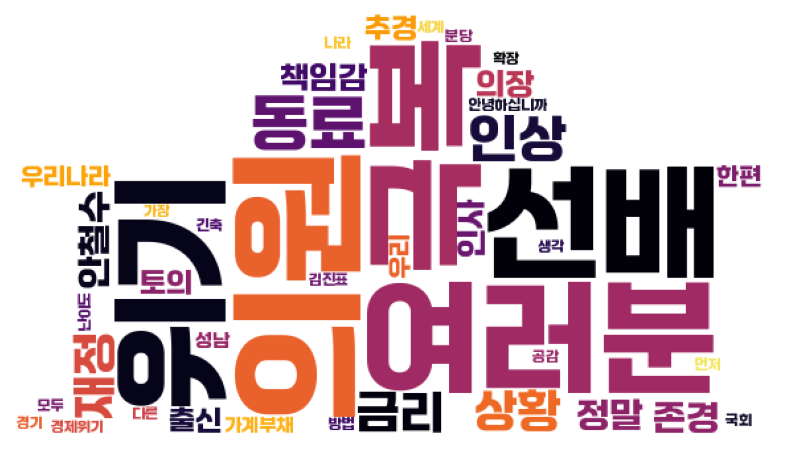

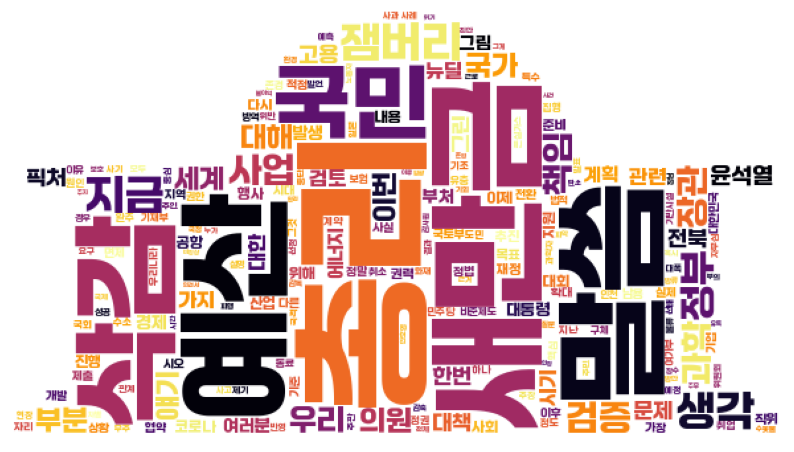

In [ ]:
# 297명 의원에 대한 워드클라우드 생성하여 png파일로 저장
# 국회(부)의장 혹은 발언기록이 없는 의원은 예외처리
except_word = {'국회(부)의장 또는 본회의 발언 기록이 존재하지 않습니다.' : 11}
for i in range(len(dept_cds)):
    tmp = df[df['dept_cd'] == df1['dept_cd'][i]]
    
    nouns = tmp['speaking'].apply(okt.nouns)
    nouns = nouns.explode()
    df_word = pd.DataFrame({'word' : nouns})
    df_word['count'] = df_word['word'].str.len()
    df_word = df_word.query('count >= 2')
    df_word = df_word.groupby(
    'word', as_index = False
    ).agg(
        n = ('word', 'count')
        ).sort_values('n', ascending = False)
    dic_word = df_word.set_index('word').to_dict()['n']
        
    wc = WordCloud(random_state=6000,
              font_path = "/Library/Fonts/JalnanGothicTTF.ttf",
              width = 400, height = 400,
              background_color = 'white',
              mask = img, colormap='inferno')
    
    try:
        img_wordcloud = wc.generate_from_frequencies(dic_word)
    except:
        img_wordcloud = wc.generate_from_frequencies(except_word)
    
    plt.figure(figsize=(10,10))
    plt.imshow(img_wordcloud)
    plt.axis("off")
    # plt.show()
    plt.savefig(f'../First_project/dataes/wordcloud_img/{dept_cds[i]}')